In [1]:
import sys
print(sys.executable)
!{sys.executable} --version


C:\coding\Anaconda\envs\sysl2\python.exe
Python 3.9.4


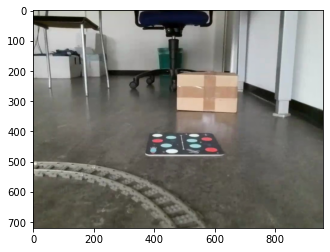

In [2]:
import cv2
import matplotlib.pyplot as plt
im = cv2.imread("./fps_1_frame_011.jpg", cv2.IMREAD_COLOR)
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
plt.imshow(im)

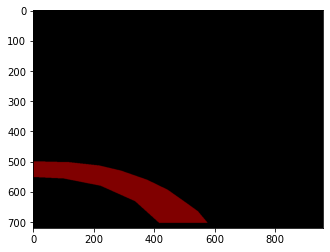

In [3]:
mask_im = cv2.imread("./fps_1_frame_011_mask.png", cv2.IMREAD_COLOR)
mask_im = cv2.cvtColor(mask_im, cv2.COLOR_BGR2RGB)
plt.imshow(mask_im)


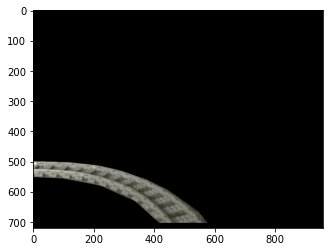

In [4]:
import numpy as np
mask = mask_im.sum(axis=2)==0
mask = np.stack([mask,mask,mask], axis=2)
im[mask]=0
plt.imshow(im)

False
True


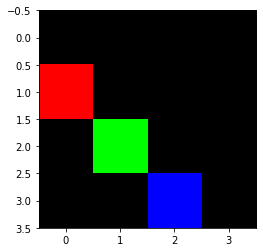

In [5]:
import torch
def non_black_pixel(im, more_than):
    temp = im.reshape(-1,3)
    temp = temp.sum(axis=1) > 0
    temp = temp.sum()
    return (temp >= more_than).item()

test = [[[0,0,0,],[0,0,0,],[0,0,0,],[0,0,0,]],
[[255,0,0,],[0,0,0,],[0,0,0,],[0,0,0,]],
[[0,0,0,],[0,255,0,],[0,0,0,],[0,0,0,]],
[[0,0,0,],[0,0,0,],[0,0,255,],[0,0,0,]]] # 4x4
test2 = [[[255,0,0,],[0,255,0,],[0,0,0,],[0,0,0,]],
[[255,0,0,],[0,255,0,],[0,0,0,],[0,0,0,]],
[[255,0,0,],[0,255,0,],[0,0,0,],[0,0,0,]],
[[255,0,0,],[0,255,0,],[0,0,255,],[0,0,0,]]] # 4x4

test_im = torch.IntTensor(test)
test_im2 = torch.IntTensor(test2)
plt.imshow(test_im)

print(non_black_pixel(test_im, 8))
print(non_black_pixel(test_im2, 8))

In [6]:
from torch import nn, Tensor
tensor_im = torch.IntTensor(im).unsqueeze(0)        
kernel_size = 100
stride = 50
unf = tensor_im.unfold(1, kernel_size, stride).unfold(2, kernel_size, stride)
unf = unf.transpose(3,4)
unf = unf.transpose(4,5)
unf = unf.squeeze(dim=0)
patches = []
for ix, x in enumerate(unf):
    for iy, y in enumerate(x):
        sample = y
        if non_black_pixel(sample,2000):
            patches.append(sample.detach().numpy())
print(len(patches))




25


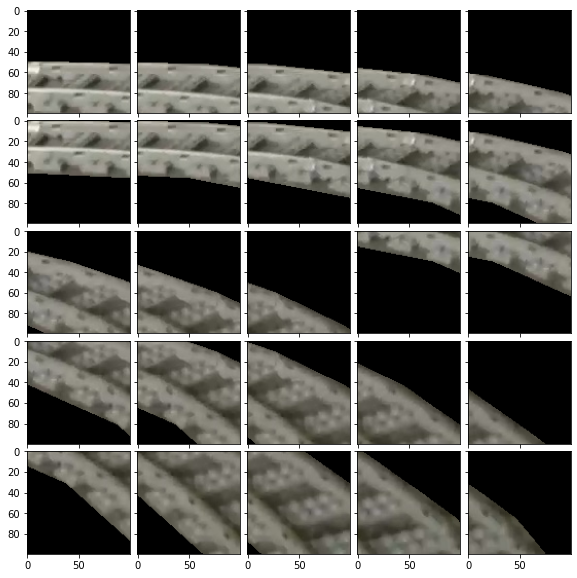

In [7]:
from mpl_toolkits.axes_grid1 import ImageGrid
fig = plt.figure(figsize=(10, 10))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(5, 5),  # creates 5x5 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for ax, patch in zip(grid, patches):
    ax.imshow(patch)


torch.Size([800, 1000, 3])
torch.Size([15, 19, 100, 100, 3])


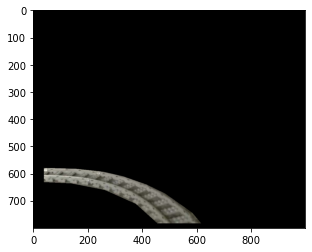

In [8]:
kernel_size = 100
stride = 50
padding_x = kernel_size - (tensor_im.shape[1] % kernel_size)
padding_y = kernel_size - (tensor_im.shape[2] % kernel_size)
padding = (0,0,padding_y,0,padding_x,0)

im_wpad = torch.from_numpy(im)
im_wpad = torch.nn.ConstantPad3d(padding, 0)(im_wpad)
unf_wpad = im_wpad.unsqueeze(dim=0)
unf_wpad = unf_wpad.unfold(1, kernel_size, stride).unfold(2, kernel_size, stride)
unf_wpad = unf_wpad.transpose(3,4)
unf_wpad = unf_wpad.transpose(4,5)
unf_wpad = unf_wpad.squeeze(dim=0)


print(im_wpad.shape)
print(unf_wpad.shape)
plt.imshow(im_wpad)

torch.Size([800, 1000, 3])
(800, 1000, 3)


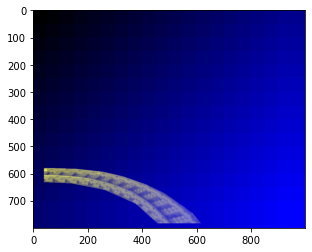

In [9]:
def novelity_value(patch):
    """
    patch: Image Tensor (default 100,100,3)
    return: 0 <= value
    """
    shape = patch.shape
    return 1 # TODO


out_image = im_wpad.detach().cpu().numpy()
aggregator = np.zeros((out_image.shape[0:2]))       

dix = 0
for ix, x in enumerate(unf_wpad):
    diy = 0
    for iy, y in enumerate(x):
        patch = y 
        #v = novelity_value(patch) # TODO 
        v = ix+iy # TEST
        curent_aggegator = aggregator[dix:dix+kernel_size,diy:diy+kernel_size]
        shape = curent_aggegator.shape
        new_vals = np.maximum(curent_aggegator,np.full(shape, v))
        aggregator[dix:dix+kernel_size,diy:diy+kernel_size] = new_vals
        diy += stride
    dix += stride

aggregator  *= 254/aggregator.max()  
    

print(im_wpad.shape)
print(out_image.shape)
out_image[:, :, 2] = aggregator

plt.imshow(out_image)



    

In [10]:
#gen full data Train
from pathlib import Path
data_path = Path("..\gen_data\data").resolve()

all_images = []
for current_mask_path in data_path.rglob("*_mask.png"):
    current_mask = cv2.imread(str(current_mask_path), cv2.IMREAD_COLOR)
    current_mask = cv2.cvtColor(current_mask, cv2.COLOR_BGR2RGB)
    current_mask  = current_mask.sum(axis=2)==0
    current_mask  = np.stack([current_mask ,current_mask, current_mask], axis=2)
    
    current_im_path = current_mask_path.parent/(current_mask_path.stem.removesuffix("_mask")+".jpg")
    current_im = cv2.imread(str(current_im_path), cv2.IMREAD_COLOR)
    current_im = cv2.cvtColor(current_im, cv2.COLOR_BGR2RGB)
    
    current_im[current_mask] = 0
    all_images.append((current_im_path,current_im))

WindowsPath('C:/projects/sysl2/rail_novelity_training/gen_data/data/2021-07-01-14-51-15/fps_1_frame_028.jpg')

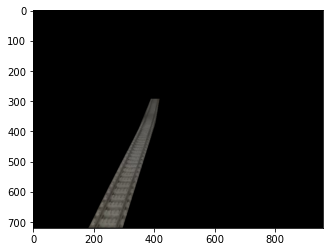

In [11]:
sample_path, sample_im = all_images[12]
plt.imshow(sample_im) #sample image
sample_path

In [12]:
from torch import Tensor
import torch

data = []

for sample_path, sample_im in all_images:
    tensor_im = torch.IntTensor(sample_im).unsqueeze(0)        
    kernel_size = 100
    stride = 50
    unf = tensor_im.unfold(1, kernel_size, stride).unfold(2, kernel_size, stride)
    unf = unf.transpose(3,4)
    unf = unf.transpose(4,5)
    unf = unf.squeeze(dim=0)
    for ix, x in enumerate(unf):
        for iy, y in enumerate(x):
            sample = y
            if non_black_pixel(sample,2000):
                data.append(sample.detach().numpy())



<ipython-input-13-c7c4dfe17757>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


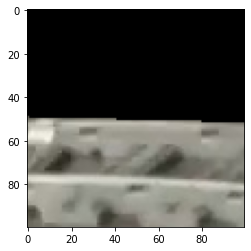

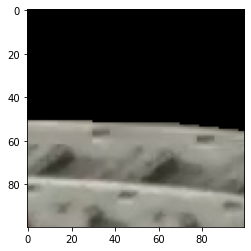

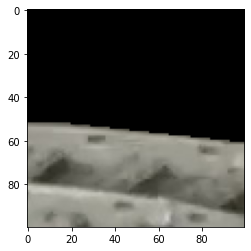

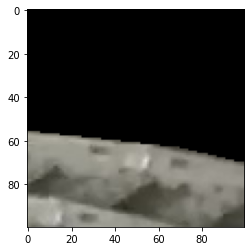

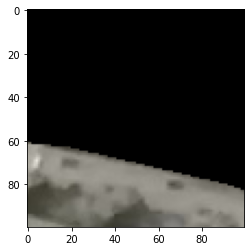

...

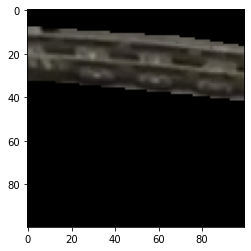

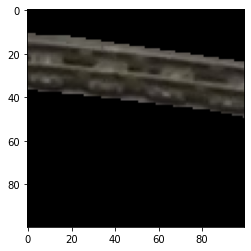

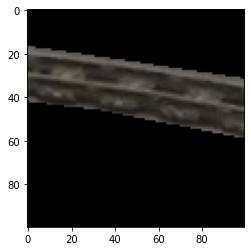

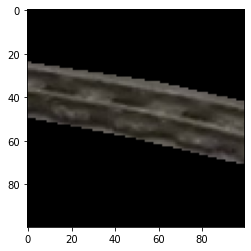

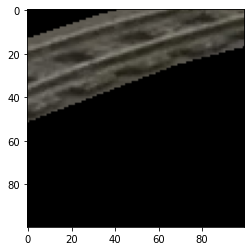

In [13]:
import ipyplot
for current_im in data[::10]:
    plt.figure()
    plt.imshow(current_im)

In [80]:
num_data = len(data)
np.random.seed(0)
train_indicies = np.random.choice(range(num_data), int(num_data*0.8), replace=False)
train_data = [patch for i,patch in enumerate(data) if i in train_indicies]
test_data = [patch for i,patch in enumerate(data) if i not in train_indicies]

print(len(train_data), len(test_data), num_data)

642 161 803


In [81]:
from sklearn.ensemble import IsolationForest
flattend_train_data = [current_data.flatten() for current_data in train_data]
clf = IsolationForest(random_state=0, contamination=0).fit(flattend_train_data)

In [82]:
flattend_test_data = [current_data.flatten() for current_data in test_data]
clf.predict(flattend_test_data)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1])

array([ 1, -1, -1, -1])

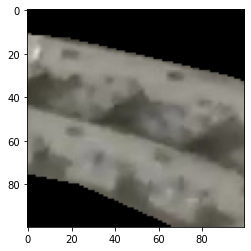

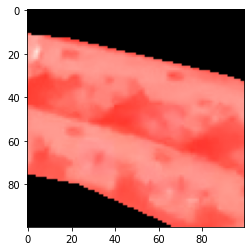

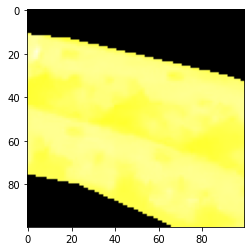

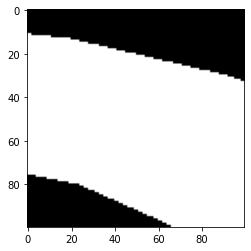

In [83]:
bad_data = test_data[0].copy()
bad_test_data = []


bad_test_data.append(bad_data.copy().flatten())
plt.figure()
plt.imshow(bad_data)

bad_mask = bad_data.sum(axis=2)>0
false_mask = np.zeros(bad_mask.shape)==1



bad_mask = bad_data.sum(axis=2)>0
bad_mask = np.stack([bad_mask,false_mask,false_mask], axis=2)
bad_data[bad_mask]=255
bad_test_data.append(bad_data.copy().flatten())
plt.figure()
plt.imshow(bad_data)

bad_mask = bad_data.sum(axis=2)>0
bad_mask = np.stack([false_mask,bad_mask,false_mask], axis=2)
bad_data[bad_mask]=255
bad_test_data.append(bad_data.copy().flatten())
plt.figure()
plt.imshow(bad_data)

bad_mask = bad_data.sum(axis=2)>0
bad_mask = np.stack([false_mask,false_mask,bad_mask], axis=2)
bad_data[bad_mask]=255
bad_test_data.append(bad_data.copy().flatten())
plt.figure()
plt.imshow(bad_data)

clf.predict(bad_test_data)

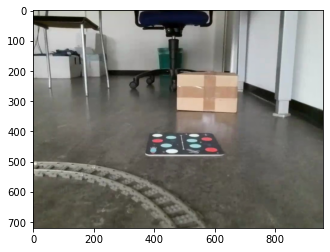

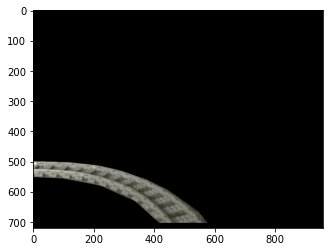

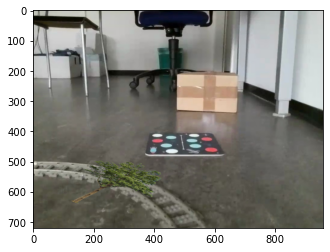

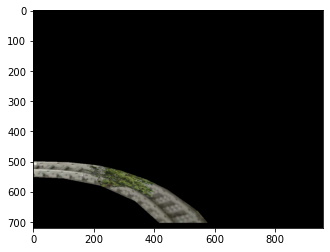

In [97]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

original = cv2.imread("./fps_1_frame_011.jpg", cv2.IMREAD_COLOR)
original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
plt.figure()
plt.imshow(original)
mask = cv2.imread("./fps_1_frame_011_mask.png", cv2.IMREAD_COLOR)
mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
mask = mask.sum(axis=2)==0
mask = np.stack([mask,mask,mask], axis=2)
masked = original.copy()
masked[mask]=0
plt.figure()
plt.imshow(masked)
tree = cv2.imread("./fps_1_frame_011_tree.jpg", cv2.IMREAD_COLOR)
tree = cv2.cvtColor(tree, cv2.COLOR_BGR2RGB)
plt.figure()
plt.imshow(tree)
masked_tree = tree.copy()
masked_tree[mask]=0
plt.figure()
plt.imshow(masked_tree)

In [174]:
def novelity_value(patch):
    """
    patch: Image Tensor (default 100,100,3)
    return: 0 <= value
    """
    if not non_black_pixel(patch,2000):
        return 0
    
    flattened = patch.detach().cpu().numpy().flatten()
    v = clf.predict([flattened])[0]
    if v == 1:
        return 0
    return 1

def aggregate_function(old_vals, current_vals):
    """
    patch: Image Tensor (default 100,100,3)
    return: 0 <= value
    """
    # return np.maximum(old_vals, current_vals)
    return old_vals+current_vals

def modify_img_with_aggregator(img, aggregator):
    aggregator *= 240
    aggregator = aggregator.astype(np.uint8)
    img[:, :, 0] = np.maximum(img[:, :, 1], aggregator)
    return img

def pad(img, kernel_size = 100, stride = 50):
    im = torch.from_numpy(img)
    padding_x = kernel_size - (im.shape[0] % kernel_size)
    padding_y = kernel_size - (im.shape[1] % kernel_size)
    padding = (0,0,padding_y,0,padding_x,0)

    im_wpad = torch.nn.ConstantPad3d(padding, 0)(im)
    return im_wpad

def unfold(im_wpad, kernel_size = 100, stride = 50):
    #print(im_wpad.shape)   
    unf_wpad = im_wpad.unsqueeze(dim=0)
    #print(unf_wpad.shape)
    unf_wpad = unf_wpad.unfold(1, kernel_size, stride).unfold(2, kernel_size, stride)
    #print(unf_wpad.shape)
    unf_wpad = unf_wpad.transpose(3,4)
    #print(unf_wpad.shape)
    unf_wpad = unf_wpad.transpose(4,5)
    #print(unf_wpad.shape)
    unf_wpad = unf_wpad.squeeze(dim=0)
    return unf_wpad


def relevant_patch(patch):
    return patch.sum()!=0

def detect_on_image(img_masked, img_original, kernel_size=100):  
    img_masked = img_masked.copy()
    img_original = img_original.copy()
    padded_mask = pad(img_masked)
    #plt.figure()
    #plt.imshow( padded_mask)
    padded_original = pad(img_original)
    unf = unfold(padded_mask)
    aggregator = np.zeros((im_wpad.shape[0:2]))       
    dix = 0
    for ix, x in enumerate(unf):
        diy = 0
        for iy, y in enumerate(x):
            patch = y 
            #if relevant_patch(patch):
            #    plt.figure()
            #    plt.imshow(patch)
            v = novelity_value(patch)
            old_vals = aggregator[dix:dix+kernel_size,diy:diy+kernel_size]
            shape = old_vals.shape
            current_vals = np.full(shape, v)
            new_vals = aggregate_function(current_vals,old_vals)
            aggregator[dix:dix+kernel_size,diy:diy+kernel_size] = new_vals
            diy += stride
        dix += stride
    return modify_img_with_aggregator(padded_original, aggregator)

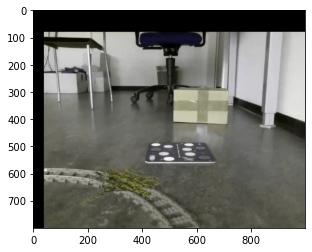

In [175]:
out = detect_on_image(masked_tree, tree)
plt.figure()
plt.imshow(out)